In [9]:
import numpy as np
import pandas as pd
import scipy as sp
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib as mpl
from matplotlib import font_manager
import sklearn
import pprint
import re
from sklearn.model_selection import train_test_split


import warnings
warnings.filterwarnings('ignore')

font_fname = 'C:/Windows/Fonts/malgun.ttf'
font_family = font_manager.FontProperties(fname=font_fname).get_name()

plt.rcParams["font.family"] = font_family
plt.rcParams["axes.unicode_minus"] = False


%matplotlib inline

In [41]:
from sklearn.linear_model import LinearRegression, Ridge, Lasso
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, mean_absolute_error
from sklearn.ensemble import RandomForestRegressor, ExtraTreesRegressor
import lightgbm as lgb
import xgboost as xgb
from sklearn.metrics import mean_squared_error, r2_score
from catboost import CatBoostRegressor

In [10]:
from sklearn.linear_model import Ridge, Lasso, LinearRegression
from sklearn.metrics import mean_squared_error, r2_score
import numpy as np
import matplotlib.pyplot as plt

In [115]:
# df = pd.read_csv('reg_data.csv')
df = pd.read_csv('reg_data_R5.csv')

In [116]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2335 entries, 0 to 2334
Columns: 138 entries, 아파트명 to 평당공급액
dtypes: bool(73), float64(18), int64(42), object(5)
memory usage: 1.3+ MB


In [137]:
df.keys()

Index(['아파트명', '법정동주소', '위도', '경도', '세대수', '임대세대수', '최고층', '최저층', '최대공급면적',
       '최소공급면적',
       ...
       '입주예정연도_2021', '입주예정연도_2022', '입주예정연도_2023', '입주예정연도_2024',
       '입주예정연도_2025', '입주예정연도_2026', '투기과열', '분양가상한제', '평당공급액', '평당_공급액'],
      dtype='object', length=139)

In [117]:
df['평당_공급액'] = (df['공급액'] / df['공급면적'])*3.3

In [118]:
y_val_col = '공급액'

In [119]:
y_val_col2 = '평당_공급액'

In [ ]:
y_val_col3 = ['공급액', '평당_공급액']

In [25]:
cate_list = ['아파트명', '법정동주소', '위도', '경도', '현관구조', '역사명', '지하철역']

In [26]:
con_list = ['세대수', '임대세대수', '최고층', '최저층', '최대공급면적', '최소공급면적', '총아파트동수', '용적률', '건폐율', '세대평균_주차대수', '공급면적', '전용면적',
 '전용율', '방수', '욕실수', '지하철역_거리', '병원_1차', '병원_2차', '병원_3차', '공원', '대학', '소매', '음식', '교육', '장례식장', '보건의료', '유원지오락',
 '총인구수', '타입']

In [101]:
len(con_list)

29

In [4]:
one_hot_list = ['대형건설사', '노선_진접선', '노선_8호선', '노선_경강선', '노선_경춘선', '노선_신분당선', '노선_3호선', '노선_수인선', '노선_경의중앙선', '노선_우이신설선',
 '노선_분당선', '노선_김포골드라인', '노선_인천_1호선', '노선_의정부선', '노선_에버라인', '노선_인천_2호선', '노선_신림선', '노선_6호선', '노선_2호선', '노선_1호선',
 '노선_서해선', '노선_9호선', '노선_4호선', '노선_5호선', '노선_인천국제공항선', '노선_7호선', '광역_경기', '광역_서울', '광역_인천', '기초_경기_가평군', 
 '기초_경기_고양시', '기초_경기_과천시', '기초_경기_광명시', '기초_경기_광주시', '기초_경기_구리시', '기초_경기_군포시', '기초_경기_김포시', '기초_경기_남양주시',
 '기초_경기_동두천시', '기초_경기_부천시', '기초_경기_성남시', '기초_경기_수원시', '기초_경기_시흥시', '기초_경기_안산시', '기초_경기_안성시', '기초_경기_안양시',
 '기초_경기_양주시', '기초_경기_양평군', '기초_경기_여주시', '기초_경기_연천군', '기초_경기_오산시', '기초_경기_용인시', '기초_경기_의왕시', '기초_경기_의정부시',
 '기초_경기_이천시', '기초_경기_파주시', '기초_경기_평택시', '기초_경기_포천시', '기초_경기_하남시', '기초_경기_화성시', '기초_서울_강남구', '기초_서울_강동구',
 '기초_서울_강북구', '기초_서울_강서구', '기초_서울_관악구', '기초_서울_광진구', '기초_서울_구로구', '기초_서울_노원구', '기초_서울_도봉구', '기초_서울_동대문구',
 '기초_서울_동작구', '기초_서울_서대문구', '기초_서울_서초구', '기초_서울_성동구', '기초_서울_성북구', '기초_서울_송파구', '기초_서울_양천구', '기초_서울_영등포구',
 '기초_서울_은평구', '기초_서울_종로구', '기초_서울_중구', '기초_서울_중랑구', '기초_인천_강화군', '기초_인천_계양구', '기초_인천_남동구', '기초_인천_동구',
 '기초_인천_미추홀구', '기초_인천_부평구', '기초_인천_서구', '기초_인천_연수구', '기초_인천_중구', '입주예정연도_2020', '입주예정연도_2021', '입주예정연도_2022',
 '입주예정연도_2023', '입주예정연도_2024', '입주예정연도_2025', '입주예정연도_2026']

In [5]:
one_hot_list2 = one_hot_list + ['투기과열', '분양가상한제']

In [8]:
len(one_hot_list2)

100

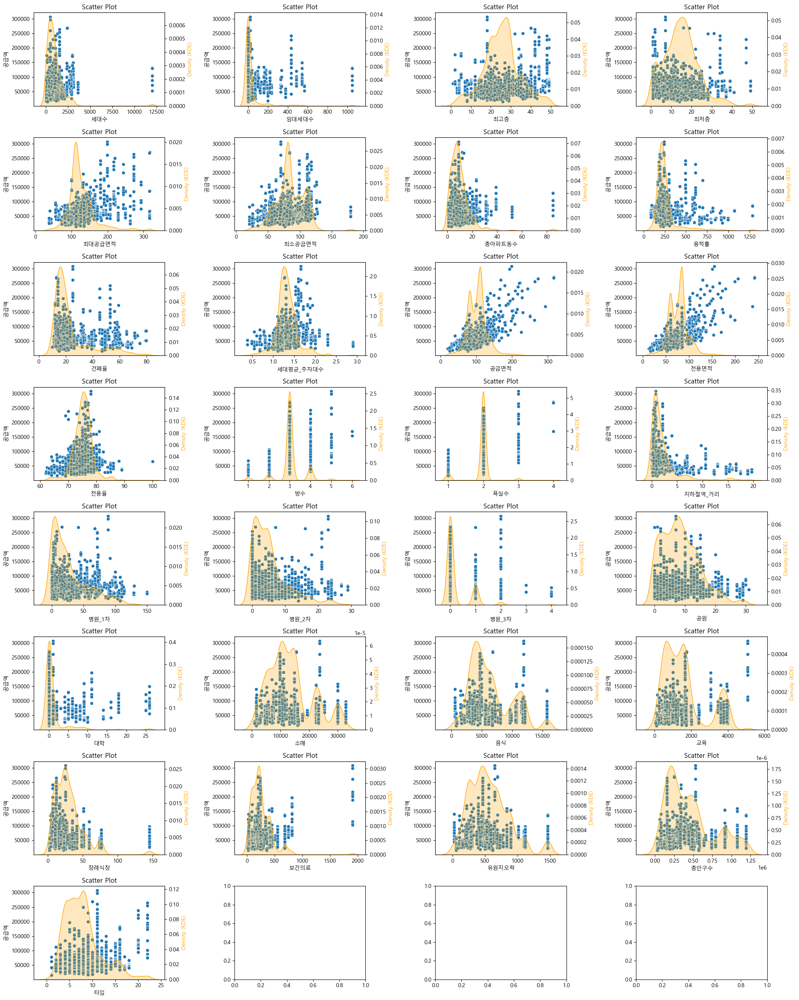

In [78]:
fig, axes = plt.subplots(nrows=8, ncols=4, figsize=(20, 25))

for i, col in enumerate(df[con_list].columns):  
    row_idx = i // 4
    col_idx = i % 4
    ax = axes[row_idx, col_idx]
    
    sns.scatterplot(x=df[col], y=df['공급액'], ax=ax)
    ax.set_xlabel(col)
    ax.set_ylabel('공급액')
    ax.set_title(col,'vs 공급액')
    
    # Twin the axes for two different y-axes on the same plot
    ax2 = ax.twinx()
    sns.kdeplot(df[col], shade=True, ax=ax2, color='orange')
    ax2.set_ylabel('Density (KDE)', color='orange')
    
plt.tight_layout()
plt.show()

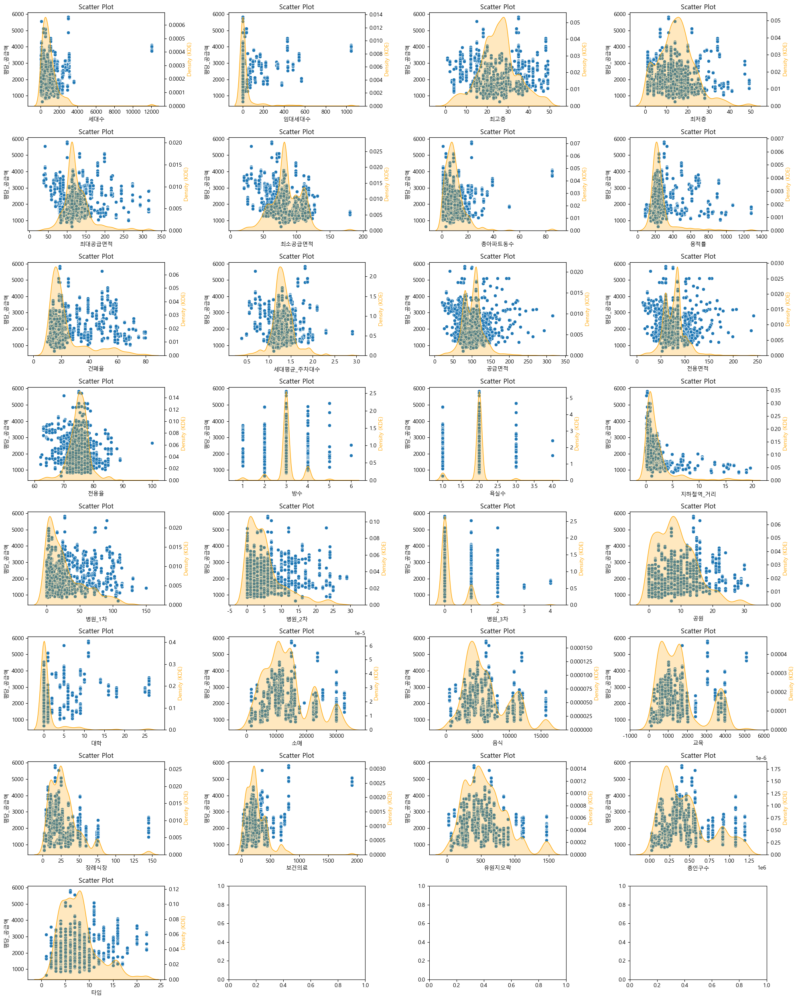

In [73]:
fig, axes = plt.subplots(nrows=8, ncols=4, figsize=(20, 25))

for i, col in enumerate(df[con_list].columns):  
    row_idx = i // 4
    col_idx = i % 4
    ax = axes[row_idx, col_idx]
    
    sns.scatterplot(x=df[col], y=df['평당_공급액'], ax=ax)
    ax.set_xlabel(col)
    ax.set_ylabel('평당_공급액')
    ax.set_title(col,'vs 평당_공급액')
    
    # Twin the axes for two different y-axes on the same plot
    ax2 = ax.twinx()
    sns.kdeplot(df[col], shade=True, ax=ax2, color='orange')
    ax2.set_ylabel('Density (KDE)', color='orange')
    
plt.tight_layout()
plt.show()

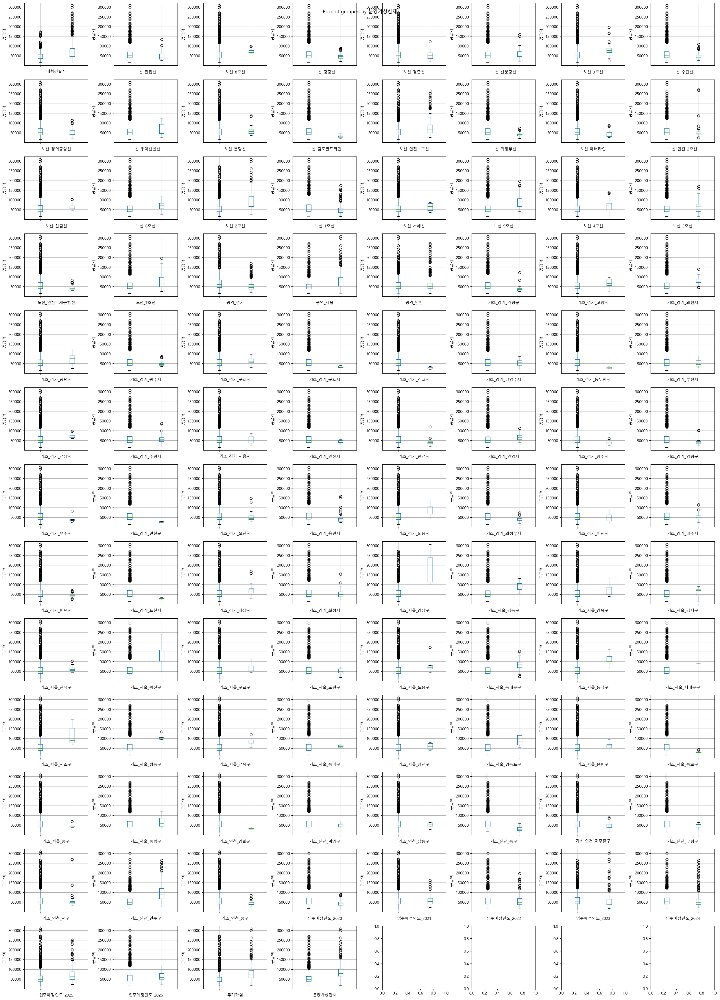

In [141]:
plot_df = df[one_hot_list2]

fig, axes = plt.subplots(nrows=13, ncols=8, figsize=(25, 35))

for i, col in enumerate(df[one_hot_list2].columns):  # 공급액 컬럼은 제외
    row_idx = i // 8
    col_idx = i % 8
    ax = axes[row_idx, col_idx]
    df.boxplot(column='공급액', by=col, ax=ax)
    ax.set_title('')
    ax.set_xlabel(col)
    ax.set_ylabel('공급액')
    ax.set_xticklabels([])

plt.tight_layout()
plt.show()

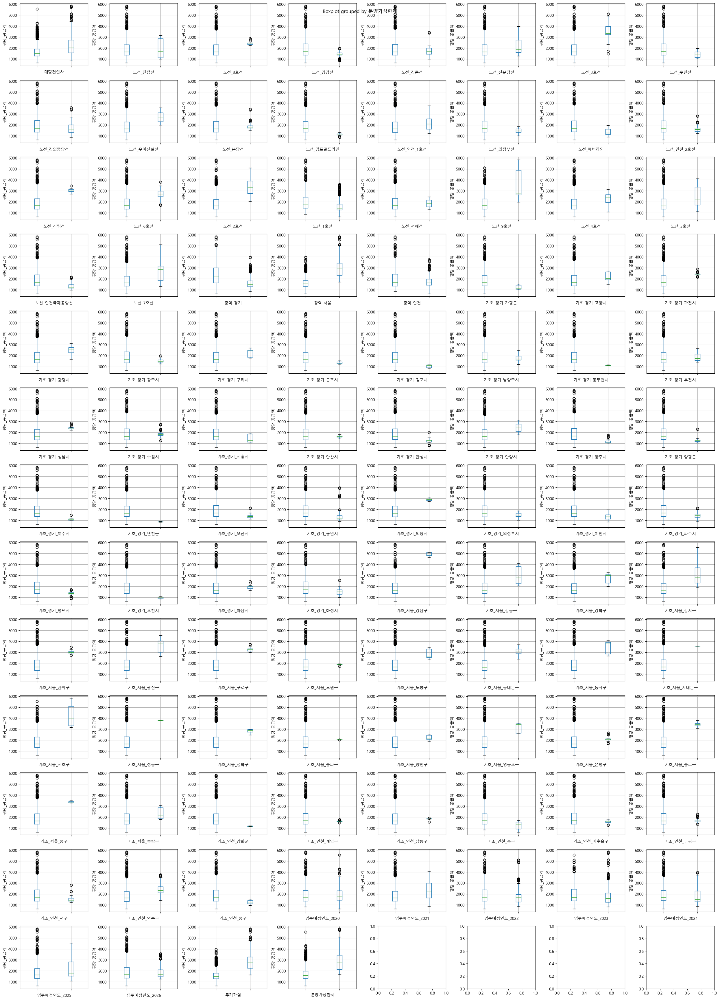

In [142]:
plot_df = df[one_hot_list2]

fig, axes = plt.subplots(nrows=13, ncols=8, figsize=(25, 35))

for i, col in enumerate(df[one_hot_list2].columns):  # 공급액 컬럼은 제외
    row_idx = i // 8
    col_idx = i % 8
    ax = axes[row_idx, col_idx]
    df.boxplot(column='평당_공급액', by=col, ax=ax)
    ax.set_title('')
    ax.set_xlabel(col)
    ax.set_ylabel('평당_공급액')
    ax.set_xticklabels([])

plt.tight_layout()
plt.show()

In [139]:
column_sums = df[one_hot_list2].sum()

columns_with_sum_above_100 = column_sums[column_sums >= 100].index.tolist()

print("Columns with sum above 100:", columns_with_sum_above_100)

Columns with sum above 100: ['대형건설사', '노선_경강선', '노선_수인선', '노선_경의중앙선', '노선_인천_1호선', '노선_에버라인', '노선_인천_2호선', '노선_1호선', '노선_4호선', '노선_5호선', '노선_7호선', '광역_경기', '광역_서울', '광역_인천', '기초_경기_평택시', '기초_경기_화성시', '기초_인천_연수구', '입주예정연도_2021', '입주예정연도_2022', '입주예정연도_2023', '입주예정연도_2024', '입주예정연도_2025', '입주예정연도_2026', '투기과열', '분양가상한제']


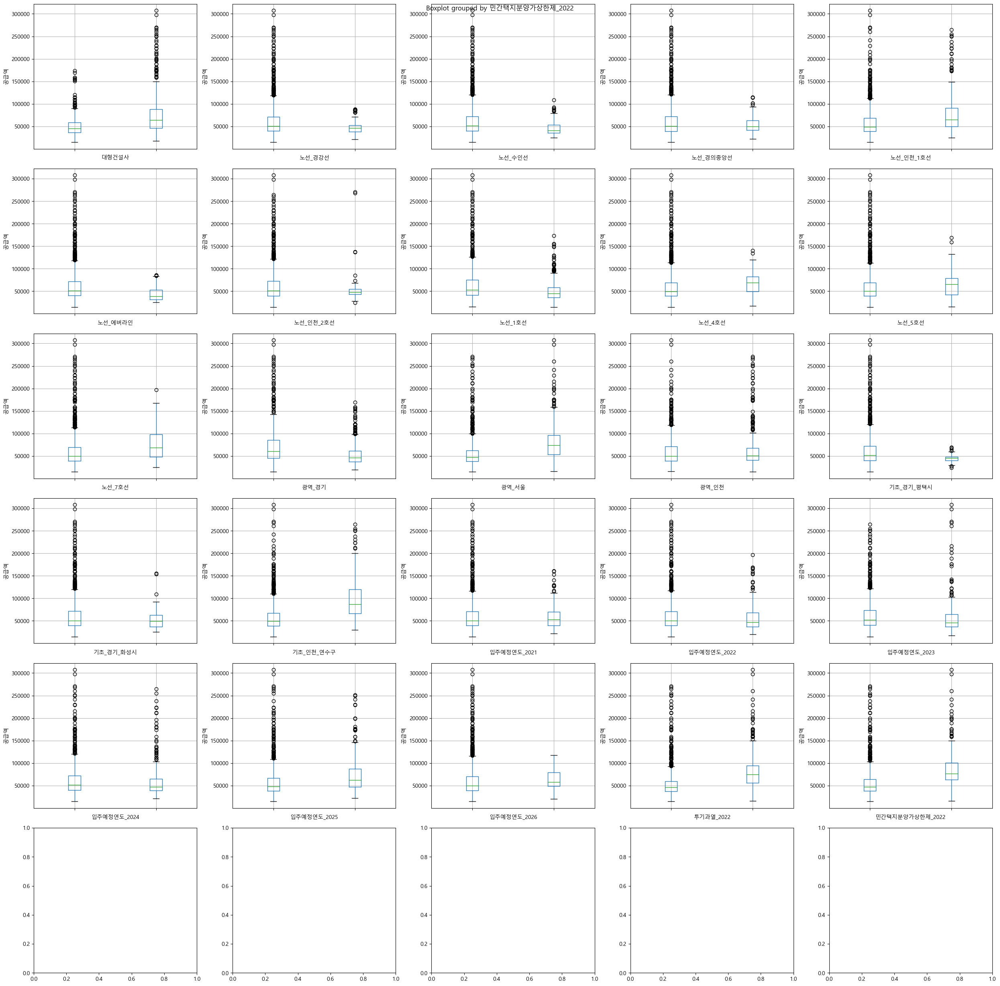

In [95]:
plot_df = df[columns_with_sum_above_100]

fig, axes = plt.subplots(nrows=5, ncols=5, figsize=(25, 25))

for i, col in enumerate(df[columns_with_sum_above_100].columns): 
    row_idx = i // 5
    col_idx = i % 5
    ax = axes[row_idx, col_idx]
    df.boxplot(column='공급액', by=col, ax=ax)
    ax.set_title('')
    ax.set_xlabel(col)
    ax.set_ylabel('공급액')
    ax.set_xticklabels([])

plt.tight_layout()
plt.show()

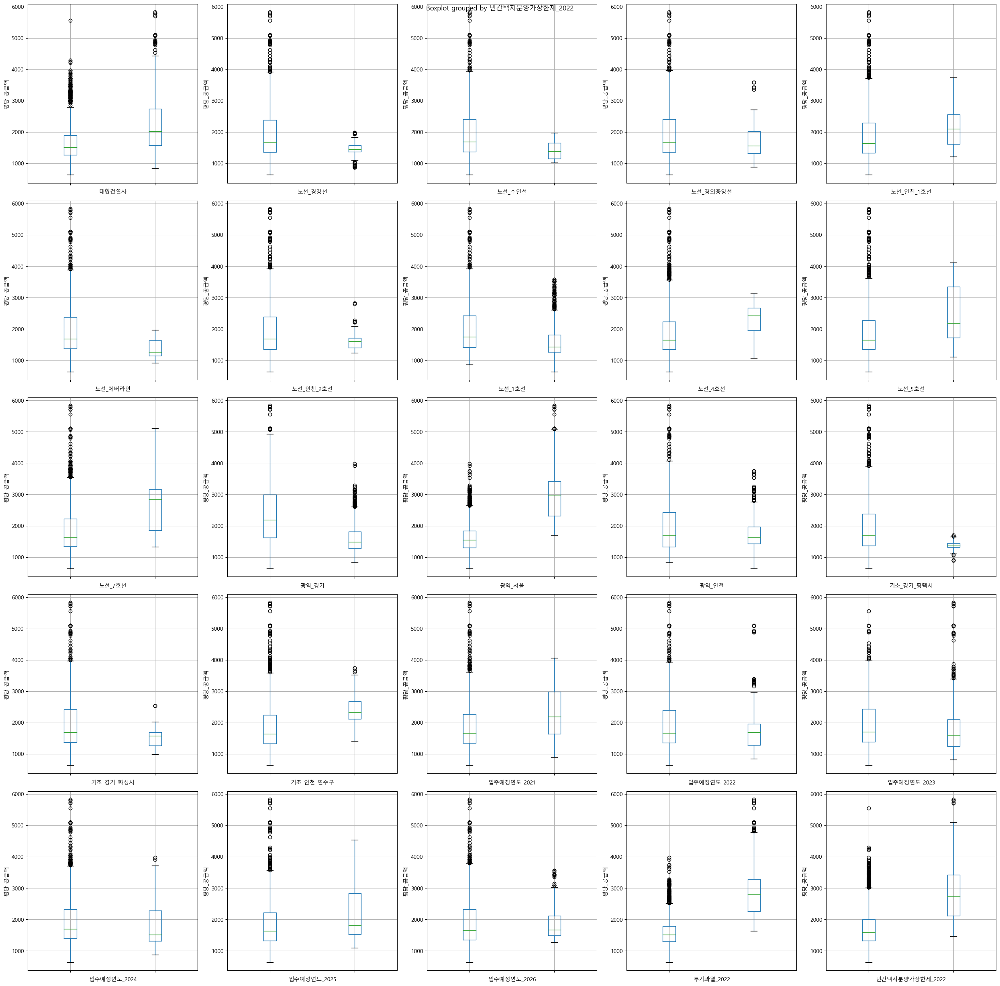

In [96]:
plot_df = df[columns_with_sum_above_100]

fig, axes = plt.subplots(nrows=5, ncols=5, figsize=(25, 25))

for i, col in enumerate(df[columns_with_sum_above_100].columns):  # 공급액 컬럼은 제외
    row_idx = i // 5
    col_idx = i % 5
    ax = axes[row_idx, col_idx]
    df.boxplot(column='평당_공급액', by=col, ax=ax)
    ax.set_title('')
    ax.set_xlabel(col)
    ax.set_ylabel('평당_공급액')
    ax.set_xticklabels([])

plt.tight_layout()
plt.show()

In [ ]:
select_list3 = ['타입','지하철역_거리','공급면적','전용면적','대형건설사', '노선_경강선', '노선_수인선', '노선_경의중앙선', '노선_인천_1호선', '노선_에버라인', '노선_인천_2호선', '노선_1호선', '노선_4호선', '노선_5호선', '노선_7호선', '광역_경기', '광역_서울', '기초_경기_평택시', '기초_경기_화성시', '기초_인천_연수구', '입주예정연도_2022', '입주예정연도_2023', '입주예정연도_2024', '입주예정연도_2025', '입주예정연도_2026']

LightGBM
XGBoost 
catboost
random forest
ExtraTrees
Ridge
Lasso
Ordinary Least Squares Regression

In [104]:
df2 = df.drop(cate_list, axis=1)

### 전부다

In [105]:
X = df2.drop(y_val_col, axis=1)
y = df[y_val_col]

In [106]:
# 데이터 준비 (X는 원핫 인코딩된 특성, y는 타겟 변수)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
X_tra, X_val, y_tra, y_val = train_test_split(X_train, y_train, test_size=0.2, random_state=42)

In [108]:
# 모델들과 모델명 리스트 준비
linear_models = [
    ('Ridge', Ridge(alpha=1.0)),
    ('Lasso', Lasso(alpha=1.0)),
    ('Ordinary Least Squares', LinearRegression())
]

In [109]:
# 결과 저장용 리스트 초기화
linear_results = []

# 각 선형 모델 별로 작업 수행
for model_name, model in linear_models:
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    coef = model.coef_  # 회귀 계수 (영향력)
    
    # 결과 저장
    linear_results.append({
        'model': model_name,
        'predictions': y_pred,
        'coefficients': coef
    })

In [113]:
# 결과 저장용 리스트 초기화
performance_metrics = []

# 각 선형 모델의 예측 값에 대한 성능 메트릭 계산
for result in linear_results:
    model_name = result['model']
    y_pred = result['predictions']
    y_true = y_test  # 실제 타겟 변수값
    
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    mse = mean_squared_error(y_true, y_pred)
    r2 = r2_score(y_true, y_pred)
    
    performance_metrics.append({
        'model': model_name,
        'RMSE': rmse,
        'MAE': mae,
        'MSE': mse,
        'R2': r2
    })
    
# 모델명과 해당 모델의 성능 메트릭을 출력
for metrics in performance_metrics:
    print(f"{metrics['model']} - RMSE: {metrics['RMSE']:.2f}, MAE: {metrics['MAE']:.2f}, MSE: {metrics['MSE']:.2f}, R2: {metrics['R2']:.4f}")

Ridge - RMSE: 11059.89, MAE: 8114.92, MSE: 122321111.47, R2: 0.8598
Lasso - RMSE: 10960.97, MAE: 8081.60, MSE: 120142881.31, R2: 0.8623
Ordinary Least Squares - RMSE: 10958.57, MAE: 8082.18, MSE: 120090288.46, R2: 0.8624


In [121]:
# 모델들과 모델명 리스트 준비
models = [
    ('Random Forest', RandomForestRegressor(n_estimators=1000, random_state=42)),
    ('ExtraTrees', ExtraTreesRegressor(n_estimators=1000, random_state=42)),
    ('LightGBM', lgb.LGBMRegressor(n_estimators=1000, random_state=42)),
    ('XGBoost', xgb.XGBRegressor(n_estimators=1000, random_state=42)),
    ('CatBoost', CatBoostRegressor(iterations=1000, depth=12, learning_rate=0.1, loss_function='RMSE', random_state=42))
]

In [122]:
# 결과 저장용 리스트 초기화
results = []

# 각 모델 별로 작업 수행
for model_name, model in models:
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    feature_importances = model.feature_importances_
    
    # 결과 저장
    results.append({
        'model': model_name,
        'predictions': y_pred,
        'feature_importances': feature_importances
    })

0:	learn: 30696.9693394	total: 40.8ms	remaining: 40.7s
1:	learn: 28952.5156985	total: 62.7ms	remaining: 31.3s
2:	learn: 27414.2496537	total: 104ms	remaining: 34.6s
3:	learn: 26154.8528025	total: 146ms	remaining: 36.2s
4:	learn: 24940.8781613	total: 187ms	remaining: 37.1s
5:	learn: 23704.3691494	total: 227ms	remaining: 37.7s
6:	learn: 22509.6003640	total: 268ms	remaining: 38.1s
7:	learn: 21470.3963192	total: 310ms	remaining: 38.5s
8:	learn: 20639.9257185	total: 331ms	remaining: 36.5s
9:	learn: 19758.7526011	total: 372ms	remaining: 36.8s
10:	learn: 18891.2014605	total: 413ms	remaining: 37.1s
11:	learn: 18106.9285276	total: 453ms	remaining: 37.3s
12:	learn: 17440.8435357	total: 493ms	remaining: 37.4s
13:	learn: 16905.4664593	total: 495ms	remaining: 34.9s
14:	learn: 16296.4051504	total: 537ms	remaining: 35.2s
15:	learn: 15728.3820116	total: 577ms	remaining: 35.5s
16:	learn: 15233.2230284	total: 617ms	remaining: 35.7s
17:	learn: 14789.1821410	total: 622ms	remaining: 33.9s
18:	learn: 14369.7

In [123]:
# 결과 출력
for result in results:
    model_name = result['model']
    predictions = result['predictions']  # 예측값
    
    mse = mean_squared_error(y_test, predictions)
    rmse = np.sqrt(mse)  # RMSE 계산
    mae = mean_absolute_error(y_test, predictions)  # MAE 계산
    r2 = r2_score(y_test, predictions)
    
    print(f"{model_name} - RMSE: {rmse:.2f}, MAE: {mae:.2f}, MSE: {mse:.2f}, R2: {r2:.4f}")

Random Forest - RMSE: 9217.53, MAE: 4516.58, MSE: 84962950.89, R2: 0.9026
ExtraTrees - RMSE: 5478.53, MAE: 2624.69, MSE: 30014236.19, R2: 0.9656
LightGBM - RMSE: 8130.25, MAE: 3326.21, MSE: 66100982.96, R2: 0.9243
XGBoost - RMSE: 6841.70, MAE: 3072.45, MSE: 46808857.58, R2: 0.9464
CatBoost - RMSE: 5185.51, MAE: 2644.55, MSE: 26889512.60, R2: 0.9692


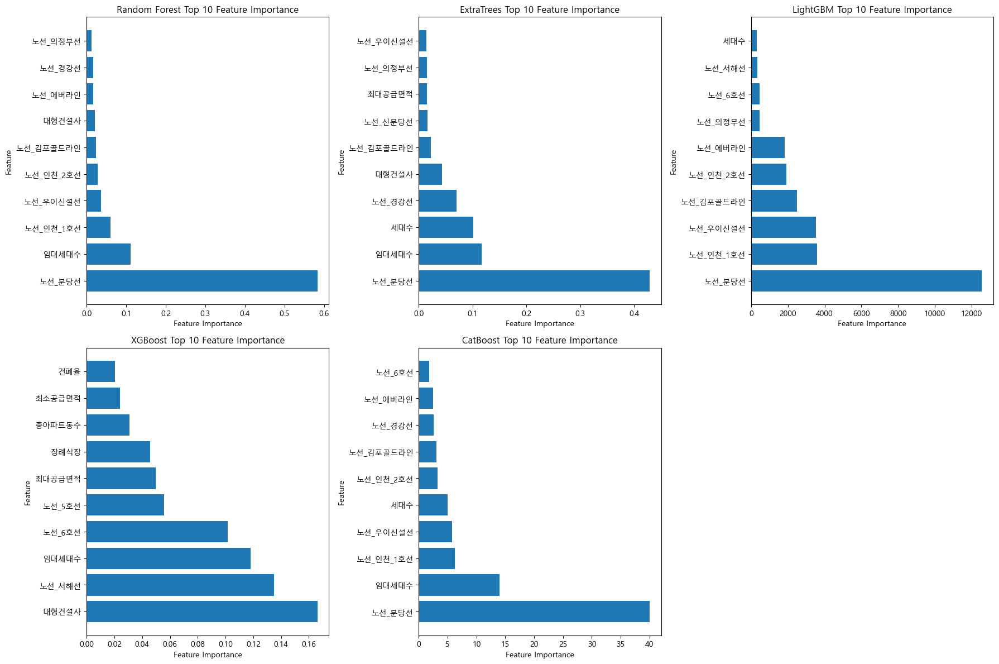

In [119]:
# 각 모델별로 피쳐 중요도 시각화
plt.figure(figsize=(18, 12))
for idx, result in enumerate(results, start=1):
    model_name = result['model']
    feature_importances = result['feature_importances']

    top_features_idx = feature_importances.argsort()[-10:][::-1]
    top_features = feature_names[top_features_idx]
    top_importances = feature_importances[top_features_idx]

    plt.subplot(2, 3, idx)
    plt.barh(top_features, top_importances)
    plt.xlabel('Feature Importance')
    plt.ylabel('Feature')
    plt.title(f'{model_name} Top 10 Feature Importance')

plt.tight_layout()
plt.show()

### EDA후 임의 선택

In [77]:
select_list3.append('공급액')

In [78]:
df3 = df[select_list3]

In [79]:
X = df3.drop(y_val_col, axis=1)
y = df3[y_val_col]

In [81]:
# 데이터 준비 (X는 원핫 인코딩된 특성, y는 타겟 변수)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
X_tra, X_val, y_tra, y_val = train_test_split(X_train, y_train, test_size=0.2, random_state=42)

In [85]:
# 모델들과 모델명 리스트 준비
linear_models = [
    ('Ridge', Ridge(alpha=1.0)),
    ('Lasso', Lasso(alpha=1.0)),
    ('Ordinary Least Squares', LinearRegression())
]

In [86]:
# 결과 저장용 리스트 초기화
linear_results = []

# 각 선형 모델 별로 작업 수행
for model_name, model in linear_models:
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    coef = model.coef_  # 회귀 계수 (영향력)
    
    # 결과 저장
    linear_results.append({
        'model': model_name,
        'predictions': y_pred,
        'coefficients': coef
    })

In [87]:
# 결과 저장용 리스트 초기화
performance_metrics = []

# 각 선형 모델의 예측 값에 대한 성능 메트릭 계산
for result in linear_results:
    model_name = result['model']
    y_pred = result['predictions']
    y_true = y_test  # 실제 타겟 변수값
    
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    mse = mean_squared_error(y_true, y_pred)
    r2 = r2_score(y_true, y_pred)
    
    performance_metrics.append({
        'model': model_name,
        'RMSE': rmse,
        'MAE': mae,
        'MSE': mse,
        'R2': r2
    })
    
# 모델명과 해당 모델의 성능 메트릭을 출력
for metrics in performance_metrics:
    print(f"{metrics['model']} - RMSE: {metrics['RMSE']:.2f}, MAE: {metrics['MAE']:.2f}, MSE: {metrics['MSE']:.2f}, R2: {metrics['R2']:.4f}")

Ridge - RMSE: 15515.53, MAE: 11505.42, MSE: 240731741.08, R2: 0.7242
Lasso - RMSE: 15530.88, MAE: 11531.14, MSE: 241208286.99, R2: 0.7236
Ordinary Least Squares - RMSE: 15532.79, MAE: 11533.92, MSE: 241267695.23, R2: 0.7236


In [88]:
# 모델들과 모델명 리스트 준비
models = [
    ('Random Forest', RandomForestRegressor(n_estimators=1000, random_state=42)),
    ('ExtraTrees', ExtraTreesRegressor(n_estimators=1000, random_state=42)),
    ('LightGBM', lgb.LGBMRegressor(n_estimators=1000, random_state=42)),
    ('XGBoost', xgb.XGBRegressor(n_estimators=1000, random_state=42)),
    ('CatBoost', CatBoostRegressor(iterations=1000, depth=12, learning_rate=0.1, loss_function='RMSE', random_state=42))
]

In [89]:
# 결과 저장용 리스트 초기화
results = []

# 각 모델 별로 작업 수행
for model_name, model in models:
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    feature_importances = model.feature_importances_
    
    # 결과 저장
    results.append({
        'model': model_name,
        'predictions': y_pred,
        'feature_importances': feature_importances
    })

0:	learn: 30764.1773123	total: 177ms	remaining: 2m 57s
1:	learn: 29117.0357273	total: 197ms	remaining: 1m 38s
2:	learn: 27633.3984161	total: 235ms	remaining: 1m 17s
3:	learn: 26075.6060115	total: 273ms	remaining: 1m 7s
4:	learn: 24649.2653544	total: 279ms	remaining: 55.6s
5:	learn: 23484.0737375	total: 317ms	remaining: 52.4s
6:	learn: 22461.0737699	total: 353ms	remaining: 50s
7:	learn: 21559.1472412	total: 389ms	remaining: 48.3s
8:	learn: 20613.2093564	total: 429ms	remaining: 47.2s
9:	learn: 19731.8968282	total: 467ms	remaining: 46.2s
10:	learn: 18950.1380130	total: 505ms	remaining: 45.4s
11:	learn: 18274.6178207	total: 543ms	remaining: 44.7s
12:	learn: 17610.5140993	total: 580ms	remaining: 44.1s
13:	learn: 16968.6811085	total: 619ms	remaining: 43.6s
14:	learn: 16367.7990342	total: 661ms	remaining: 43.4s
15:	learn: 15827.9189603	total: 700ms	remaining: 43.1s
16:	learn: 15253.0375699	total: 741ms	remaining: 42.8s
17:	learn: 14870.9551897	total: 781ms	remaining: 42.6s
18:	learn: 14493.57

In [90]:
# 결과 출력
for result in results:
    model_name = result['model']
    predictions = result['predictions']  # 예측값
    
    mse = mean_squared_error(y_test, predictions)
    rmse = np.sqrt(mse) 
    mae = mean_absolute_error(y_test, predictions) 
    r2 = r2_score(y_test, predictions)
    
    print(f"{model_name} - RMSE: {rmse:.2f}, MAE: {mae:.2f}, MSE: {mse:.2f}, R2: {r2:.4f}")

Random Forest - RMSE: 10529.65, MAE: 5695.80, MSE: 110873613.66, R2: 0.8730
ExtraTrees - RMSE: 7432.57, MAE: 3519.01, MSE: 55243144.12, R2: 0.9367
LightGBM - RMSE: 10597.60, MAE: 4695.01, MSE: 112309183.01, R2: 0.8713
XGBoost - RMSE: 8315.55, MAE: 4005.68, MSE: 69148450.00, R2: 0.9208
CatBoost - RMSE: 6152.96, MAE: 3207.14, MSE: 37858975.72, R2: 0.9566


Random Forest - RMSE: 9217.53, MAE: 4516.58, MSE: 84962950.89, R2: 0.9026
ExtraTrees - RMSE: 5478.53, MAE: 2624.69, MSE: 30014236.19, R2: 0.9656
LightGBM - RMSE: 8130.25, MAE: 3326.21, MSE: 66100982.96, R2: 0.9243
XGBoost - RMSE: 6841.70, MAE: 3072.45, MSE: 46808857.58, R2: 0.9464
CatBoost - RMSE: 5185.51, MAE: 2644.55, MSE: 26889512.60, R2: 0.9692

In [92]:
# 각 모델별로 피쳐 중요도 시각화
plt.figure(figsize=(18, 12))
for idx, result in enumerate(results, start=1):
    model_name = result['model']
    feature_importances = result['feature_importances']

    top_features_idx = feature_importances.argsort()[-10:][::-1]
    top_features = feature_names[top_features_idx]
    top_importances = feature_importances[top_features_idx]

    plt.subplot(2, 3, idx)
    plt.barh(top_features, top_importances)
    plt.xlabel('Feature Importance')
    plt.ylabel('Feature')
    plt.title(f'{model_name} Top 10 Feature Importance')

plt.tight_layout()
plt.show()

NameError: name 'feature_names' is not defined

<Figure size 1800x1200 with 0 Axes>

### 자동선택

In [94]:
from sklearn.feature_selection import RFE
from sklearn.feature_selection import SequentialFeatureSelector

In [219]:
df4 = df.drop(cate_list, axis=1)
X = df4.drop(y_val_col, axis=1)
y = df4[y_val_col]

In [144]:
# 데이터 준비 (X는 원핫 인코딩된 특성, y는 타겟 변수)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
X_tra, X_val, y_tra, y_val = train_test_split(X_train, y_train, test_size=0.2, random_state=42)

In [ ]:
# 모델들과 모델명 리스트 준비
models = [
    ('ExtraTrees', ExtraTreesRegressor(n_estimators=1000, random_state=42)),
    ('LightGBM', lgb.LGBMRegressor(n_estimators=1000, random_state=42)),
    ('XGBoost', xgb.XGBRegressor(n_estimators=1000, random_state=42))
]
num_selected_features = 50  # 선택할 특성의 개수
for name, model in models:
    rfe = RFE(model, n_features_to_select=num_selected_features)
    rfe.fit(X_train, y_train)
    
    selected_features = np.where(rfe.support_)[0]
    print(f"Selected features for {name}: {selected_features}")

Selected features for ExtraTrees: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48]
Selected features for LightGBM: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48]
Selected features for XGBoost: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48]
0:	learn: 30838.1068318	total: 57.6ms	remaining: 57.6s
1:	learn: 29214.5951054	total: 113ms	remaining: 56.5s
2:	learn: 27823.5963208	total: 172ms	remaining: 57.2s
3:	learn: 26358.4847962	total: 241ms	remaining: 60s
4:	learn: 25184.7893609	total: 326ms	remaining: 1m 4s
5:	learn: 24015.2376767	total: 386ms	remaining: 1m 4s
6:	learn: 22949.9965950	total: 449ms	remaining: 1m 3s
7:	learn: 21872.5657828	total: 507ms	remaining: 1m 2s
8:	learn: 20880.091

KeyboardInterrupt: 

In [252]:
num_selected_features = 50
model = RandomForestRegressor(n_estimators=1000, random_state=42, n_jobs=-1)

rfe = RFE(model, n_features_to_select=num_selected_features)
rfe.fit(X_train, y_train)

selected_features = np.where(rfe.support_)[0]
print(f"Selected features for RFE: {selected_features}")

Selected features for RFE: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49]


In [253]:
importances = model.feature_importances_
sorted_indices = np.argsort(importances)[::-1]
print("Feature importances:")
for i in range(num_selected_features):
    print(f"Feature {sorted_indices[i]}: Importance = {importances[sorted_indices[i]]}")

NotFittedError: This RandomForestRegressor instance is not fitted yet. Call 'fit' with appropriate arguments before using this estimator.

In [256]:
num_selected_features = 40
model = RandomForestRegressor(n_estimators=1000, random_state=42, n_jobs=-1)

rfe2 = RFE(model, n_features_to_select=num_selected_features)
rfe2.fit(X_train, y_train)

selected_features2 = np.where(rfe2.support_)[0]
print(f"Selected features for RFE2: {selected_features2}")

Selected features for RFE2: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 30 32 33 34 36 37 38 41 45 47 49]


In [ ]:
importances = model.feature_importances_
sorted_indices = np.argsort(importances)[::-1]
print("Feature importances:")
for i in range(num_selected_features):
    print(f"Feature {sorted_indices[i]}: Importance = {importances[sorted_indices[i]]}")

In [254]:
num_selected_features = 40
model = RandomForestRegressor(n_estimators=1000, random_state=42, n_jobs=-1)

# Forward selection 방식으로 SFS를 구현합니다.
sfs = SequentialFeatureSelector(model, n_features_to_select=num_selected_features, direction='forward', n_jobs=-1)
sfs.fit(X_train, y_train)

selected_features_sfs = np.where(sfs.get_support())[0]
print(f"Selected features for SFS: {selected_features_sfs}")

Selected features for SFS: [ 1  4  6  8  9 11 13 14 15 16 19 20 21 22 23 24 25 26 27 28 29 30 31 32
 33 34 35 36 37 38 39 40 41 42 43 44 45 46 48 49]


In [255]:
importances = model.feature_importances_
sorted_indices = np.argsort(importances)[::-1]
print("Feature importances:")
for i in range(num_selected_features):
    print(f"Feature {sorted_indices[i]}: Importance = {importances[sorted_indices[i]]}")

NotFittedError: This RandomForestRegressor instance is not fitted yet. Call 'fit' with appropriate arguments before using this estimator.

Selected features for RFE: [  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  30  33  42  46  49  50  53
  54  55  56  60  61  74  80  89  99 118 121 123 124 125]

Selected features for KBest: [  0   1   2   3   4   5   6   9  10  11  13  14  15  16  18  19  21  24
  25  26  34  35  39  40  41  42  46  47  49  52  53  54  55  56  60  73
  75  80  85  89  90  94  98  99 101 118 119 120 123 125]


RFE에서 50개 선택한걸로 돌린 RFE SFS

Selected features for RFE2: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 30 32 33 34 36 37 38 41 45 47 49]

Selected features for SFS: [ 1  4  6  8  9 11 13 14 15 16 19 20 21 22 23 24 25 26 27 28 29 30 31 32
 33 34 35 36 37 38 39 40 41 42 43 44 45 46 48 49]

In [ ]:
from sklearn.feature_selection import SelectKBest, f_regression

# 모델들과 모델명 리스트 준비
models = [
    ('Random Forest', RandomForestRegressor(n_estimators=1000, random_state=42)),
    ('ExtraTrees', ExtraTreesRegressor(n_estimators=1000, random_state=42)),
    ('LightGBM', lgb.LGBMRegressor(n_estimators=1000, random_state=42)),
    ('XGBoost', xgb.XGBRegressor(n_estimators=1000, random_state=42))
]

num_selected_features = 50  # 선택할 특성의 개수

for name, model in models:
    selector = SelectKBest(score_func=f_regression, k=num_selected_features)
    selector.fit(X_train, y_train)
    
    selected_features = np.where(selector.get_support())[0]
    print(f"Selected features for {name}: {selected_features}")

Selected features for Random Forest: [  0   1   2   3   4   5   6   9  10  11  13  14  15  16  18  19  21  24
  25  26  34  35  39  40  41  42  46  47  49  52  53  54  55  56  60  73
  75  80  85  89  90  94  98  99 101 118 119 120 123 125]
Selected features for ExtraTrees: [  0   1   2   3   4   5   6   9  10  11  13  14  15  16  18  19  21  24
  25  26  34  35  39  40  41  42  46  47  49  52  53  54  55  56  60  73
  75  80  85  89  90  94  98  99 101 118 119 120 123 125]
Selected features for LightGBM: [  0   1   2   3   4   5   6   9  10  11  13  14  15  16  18  19  21  24
  25  26  34  35  39  40  41  42  46  47  49  52  53  54  55  56  60  73
  75  80  85  89  90  94  98  99 101 118 119 120 123 125]
Selected features for XGBoost: [  0   1   2   3   4   5   6   9  10  11  13  14  15  16  18  19  21  24
  25  26  34  35  39  40  41  42  46  47  49  52  53  54  55  56  60  73
  75  80  85  89  90  94  98  99 101 118 119 120 123 125]
Selected features for CatBoost: [  0   1   2   3  

### SelectKBest

In [234]:
df5 = df.drop(cate_list, axis=1)
df5.drop(y_val_col, axis=1, inplace=True)
kbese = [0,   1 ,  2,   3,   4,   5,   6,   9,  10,  11,  13,  14,  15,  16,  18,  19,  21, 24,
  25,  26,  34,  35,  39,  40,  41,  42,  46,  47,  49,  52,  53,  54,  55,  56,  60,  73,
  75,  80,  85,  89,  90,  94,  98,  99, 101, 118, 119, 120, 123, 125]

kbese_col = df5.columns[kbese]

In [235]:
kbese_col

Index(['세대수', '임대세대수', '최고층', '최저층', '최대공급면적', '최소공급면적', '총아파트동수', '세대평균_주차대수',
       '공급면적', '전용면적', '방수', '욕실수', '대형건설사', '지하철역_거리', '병원_2차', '병원_3차', '대학',
       '교육', '장례식장', '보건의료', '노선_3호선', '노선_수인선', '노선_김포골드라인', '노선_인천_1호선',
       '노선_의정부선', '노선_에버라인', '노선_2호선', '노선_1호선', '노선_9호선', '노선_인천국제공항선',
       '노선_7호선', '타입', '광역_경기', '광역_서울', '기초_경기_과천시', '기초_경기_안성시', '기초_경기_양주시',
       '기초_경기_용인시', '기초_경기_평택시', '기초_서울_강남구', '기초_서울_강동구', '기초_서울_광진구',
       '기초_서울_동대문구', '기초_서울_동작구', '기초_서울_서초구', '기초_인천_연수구', '기초_인천_중구',
       '입주예정연도_2020', '입주예정연도_2023', '입주예정연도_2025'],
      dtype='object')

In [236]:
test_list = ['세대수', '임대세대수', '최고층', '최저층', '최대공급면적', '최소공급면적', '총아파트동수', '세대평균_주차대수',
       '공급면적', '전용면적', '방수', '욕실수', '대형건설사', '지하철역_거리', '병원_2차', '병원_3차', '대학',
       '노선_3호선', '노선_수인선', '노선_인천_1호선', '노선_에버라인', '노선_2호선', '노선_1호선',
       '노선_9호선', '노선_인천국제공항선', '노선_7호선', '타입', '광역_서울', '기초_경기_양주시',
       '기초_경기_용인시', '기초_경기_평택시', '기초_서울_강남구', '기초_서울_강동구', '기초_서울_광진구',
       '기초_서울_동대문구', '기초_서울_동작구', '기초_서울_서초구', '기초_인천_연수구', '기초_인천_중구',
       '입주예정연도_2020', '입주예정연도_2025']

In [238]:
def find_different_values(list1, list2):
    different_values = []

    for item in list1:
        if item not in list2:
            different_values.append(item)

    for item in list2:
        if item not in list1:
            different_values.append(item)

    return different_values

# 두 개의 리스트
list1 = [1, 2, 3, 4, 5]
list2 = [3, 4, 5, 6, 7]

result = find_different_values(kbese_col, test_list)
print("두 리스트에서 다른 값:", result)


두 리스트에서 다른 값: ['교육', '장례식장', '보건의료', '노선_김포골드라인', '노선_의정부선', '광역_경기', '기초_경기_과천시', '기초_경기_안성시', '입주예정연도_2023']


In [240]:
def find_different_values(list1, list2):
    different_values = []

    for item in list1:
        if item not in list2:
            different_values.append(item)

    for item in list2:
        if item not in list1:
            different_values.append(item)

    return different_values

# 두 개의 리스트
result = find_different_values(RFE_col, kbese_col)
print("두 리스트에서 다른 값:", result)

두 리스트에서 다른 값: ['용적률', '건폐율', '전용율', '병원_1차', '공원', '소매', '음식', '유원지오락', '총인구수', '노선_8호선', '노선_신분당선', '노선_4호선', '기초_경기_광명시', '기초_경기_안양시', '입주예정연도_2021', '입주예정연도_2024', '노선_3호선', '노선_수인선', '노선_김포골드라인', '노선_인천_1호선', '노선_의정부선', '노선_1호선', '노선_인천국제공항선', '기초_경기_안성시', '기초_경기_양주시', '기초_경기_평택시', '기초_서울_강동구', '기초_서울_광진구', '기초_서울_동대문구', '기초_서울_서초구', '기초_인천_중구', '입주예정연도_2020']


In [241]:
len(result)

32

In [176]:
X = df5[kbese_col]
y = df[y_val_col]

In [177]:
# 데이터 준비 (X는 원핫 인코딩된 특성, y는 타겟 변수)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
X_tra, X_val, y_tra, y_val = train_test_split(X_train, y_train, test_size=0.2, random_state=42)

In [178]:
# 모델들과 모델명 리스트 준비
linear_models = [
    ('Ridge', Ridge(alpha=1.0)),
    ('Lasso', Lasso(alpha=1.0)),
    ('Ordinary Least Squares', LinearRegression())
]

In [179]:
# 결과 저장용 리스트 초기화
linear_results = []

# 각 선형 모델 별로 작업 수행
for model_name, model in linear_models:
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    coef = model.coef_  # 회귀 계수 (영향력)
    
    # 결과 저장
    linear_results.append({
        'model': model_name,
        'predictions': y_pred,
        'coefficients': coef
    })

In [180]:
# 결과 저장용 리스트 초기화
performance_metrics = []

# 각 선형 모델의 예측 값에 대한 성능 메트릭 계산
for result in linear_results:
    model_name = result['model']
    y_pred = result['predictions']
    y_true = y_test  # 실제 타겟 변수값
    
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    mse = mean_squared_error(y_true, y_pred)
    r2 = r2_score(y_true, y_pred)
    
    performance_metrics.append({
        'model': model_name,
        'RMSE': rmse,
        'MAE': mae,
        'MSE': mse,
        'R2': r2
    })
    
# 모델명과 해당 모델의 성능 메트릭을 출력
for metrics in performance_metrics:
    print(f"{metrics['model']} - RMSE: {metrics['RMSE']:.2f}, MAE: {metrics['MAE']:.2f}, MSE: {metrics['MSE']:.2f}, R2: {metrics['R2']:.4f}")

Ridge - RMSE: 12424.70, MAE: 9400.09, MSE: 154373141.61, R2: 0.8231
Lasso - RMSE: 12423.13, MAE: 9410.70, MSE: 154334061.12, R2: 0.8232
Ordinary Least Squares - RMSE: 12426.53, MAE: 9414.40, MSE: 154418626.52, R2: 0.8231


In [181]:
# 모델들과 모델명 리스트 준비
models = [
    ('Random Forest', RandomForestRegressor(n_estimators=1000, random_state=42)),
    ('ExtraTrees', ExtraTreesRegressor(n_estimators=1000, random_state=42)),
    ('LightGBM', lgb.LGBMRegressor(n_estimators=1000, random_state=42)),
    ('XGBoost', xgb.XGBRegressor(n_estimators=1000, random_state=42)),
    ('CatBoost', CatBoostRegressor(iterations=1000, depth=12, learning_rate=0.1, loss_function='RMSE', random_state=42))
]

In [182]:
# 결과 저장용 리스트 초기화
results = []

# 각 모델 별로 작업 수행
for model_name, model in models:
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    feature_importances = model.feature_importances_
    
    # 결과 저장
    results.append({
        'model': model_name,
        'predictions': y_pred,
        'feature_importances': feature_importances
    })

0:	learn: 30642.5475821	total: 63ms	remaining: 1m 2s
1:	learn: 29089.7657373	total: 127ms	remaining: 1m 3s
2:	learn: 27545.6644474	total: 190ms	remaining: 1m 3s
3:	learn: 26110.5733181	total: 253ms	remaining: 1m 2s
4:	learn: 24854.1230236	total: 315ms	remaining: 1m 2s
5:	learn: 23650.7745854	total: 381ms	remaining: 1m 3s
6:	learn: 22575.7008106	total: 446ms	remaining: 1m 3s
7:	learn: 21520.3594686	total: 510ms	remaining: 1m 3s
8:	learn: 20537.2675278	total: 544ms	remaining: 60s
9:	learn: 19622.1548368	total: 610ms	remaining: 1m
10:	learn: 18751.3325986	total: 644ms	remaining: 57.9s
11:	learn: 18007.3708023	total: 709ms	remaining: 58.4s
12:	learn: 17307.9930904	total: 774ms	remaining: 58.7s
13:	learn: 16601.3787118	total: 841ms	remaining: 59.2s
14:	learn: 16029.2525028	total: 904ms	remaining: 59.4s
15:	learn: 15404.0703436	total: 967ms	remaining: 59.5s
16:	learn: 14817.9673152	total: 1.03s	remaining: 59.8s
17:	learn: 14280.9516150	total: 1.1s	remaining: 1m
18:	learn: 13842.0801508	total

In [183]:
# 결과 출력
for result in results:
    model_name = result['model']
    predictions = result['predictions']  # 예측값
    
    mse = mean_squared_error(y_test, predictions)
    rmse = np.sqrt(mse) 
    mae = mean_absolute_error(y_test, predictions) 
    r2 = r2_score(y_test, predictions)
    
    print(f"{model_name} - RMSE: {rmse:.2f}, MAE: {mae:.2f}, MSE: {mse:.2f}, R2: {r2:.4f}")

Random Forest - RMSE: 7859.28, MAE: 4343.63, MSE: 61768355.39, R2: 0.9292
ExtraTrees - RMSE: 6391.50, MAE: 2881.85, MSE: 40851324.62, R2: 0.9532
LightGBM - RMSE: 8367.14, MAE: 3248.02, MSE: 70009084.00, R2: 0.9198
XGBoost - RMSE: 5997.98, MAE: 3170.41, MSE: 35975708.29, R2: 0.9588
CatBoost - RMSE: 5309.06, MAE: 2868.53, MSE: 28186136.82, R2: 0.9677


Random Forest - RMSE: 9217.53, MAE: 4516.58, MSE: 84962950.89, R2: 0.9026
ExtraTrees - RMSE: 5478.53, MAE: 2624.69, MSE: 30014236.19, R2: 0.9656
LightGBM - RMSE: 8130.25, MAE: 3326.21, MSE: 66100982.96, R2: 0.9243
XGBoost - RMSE: 6841.70, MAE: 3072.45, MSE: 46808857.58, R2: 0.9464
CatBoost - RMSE: 5185.51, MAE: 2644.55, MSE: 26889512.60, R2: 0.9692

### RFE

In [186]:
df6 = df.drop(cate_list, axis=1)
df6.drop(y_val_col,axis=1, inplace=True)
RFE_index = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17,
           18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 30, 33, 42, 46, 49,
           50, 53, 54, 55, 56, 60, 61, 74, 80, 89, 99, 118, 121, 123, 124, 125]

RFE_col = df6.columns[RFE_index]

In [187]:
X = df6[RFE_col]
y = df[y_val_col]

In [188]:
# 데이터 준비 (X는 원핫 인코딩된 특성, y는 타겟 변수)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
X_tra, X_val, y_tra, y_val = train_test_split(X_train, y_train, test_size=0.2, random_state=42)

In [189]:
# 모델들과 모델명 리스트 준비
linear_models = [
    ('Ridge', Ridge(alpha=1.0)),
    ('Lasso', Lasso(alpha=1.0)),
    ('Ordinary Least Squares', LinearRegression())
]

In [190]:
# 결과 저장용 리스트 초기화
linear_results = []

# 각 선형 모델 별로 작업 수행
for model_name, model in linear_models:
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    coef = model.coef_  # 회귀 계수 (영향력)
    
    # 결과 저장
    linear_results.append({
        'model': model_name,
        'predictions': y_pred,
        'coefficients': coef
    })

In [191]:
# 결과 저장용 리스트 초기화
performance_metrics = []

# 각 선형 모델의 예측 값에 대한 성능 메트릭 계산
for result in linear_results:
    model_name = result['model']
    y_pred = result['predictions']
    y_true = y_test  # 실제 타겟 변수값
    
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    mse = mean_squared_error(y_true, y_pred)
    r2 = r2_score(y_true, y_pred)
    
    performance_metrics.append({
        'model': model_name,
        'RMSE': rmse,
        'MAE': mae,
        'MSE': mse,
        'R2': r2
    })
    
# 모델명과 해당 모델의 성능 메트릭을 출력
for metrics in performance_metrics:
    print(f"{metrics['model']} - RMSE: {metrics['RMSE']:.2f}, MAE: {metrics['MAE']:.2f}, MSE: {metrics['MSE']:.2f}, R2: {metrics['R2']:.4f}")

Ridge - RMSE: 12287.96, MAE: 9109.50, MSE: 150993897.00, R2: 0.8270
Lasso - RMSE: 12275.17, MAE: 9090.67, MSE: 150679774.14, R2: 0.8274
Ordinary Least Squares - RMSE: 12289.31, MAE: 9092.82, MSE: 151027211.32, R2: 0.8270


In [192]:
# 모델들과 모델명 리스트 준비
models = [
    ('Random Forest', RandomForestRegressor(n_estimators=1000, random_state=42)),
    ('ExtraTrees', ExtraTreesRegressor(n_estimators=1000, random_state=42)),
    ('LightGBM', lgb.LGBMRegressor(n_estimators=1000, random_state=42)),
    ('XGBoost', xgb.XGBRegressor(n_estimators=1000, random_state=42)),
    ('CatBoost', CatBoostRegressor(iterations=1000, depth=12, learning_rate=0.1, loss_function='RMSE', random_state=42))
]

In [193]:
# 결과 저장용 리스트 초기화
results = []

# 각 모델 별로 작업 수행
for model_name, model in models:
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    feature_importances = model.feature_importances_
    
    # 결과 저장
    results.append({
        'model': model_name,
        'predictions': y_pred,
        'feature_importances': feature_importances
    })

0:	learn: 30776.6673508	total: 81.6ms	remaining: 1m 21s
1:	learn: 29183.6199027	total: 172ms	remaining: 1m 25s
2:	learn: 27731.2771153	total: 259ms	remaining: 1m 25s
3:	learn: 26300.6246588	total: 344ms	remaining: 1m 25s
4:	learn: 24943.2568129	total: 430ms	remaining: 1m 25s
5:	learn: 23646.3952222	total: 516ms	remaining: 1m 25s
6:	learn: 22427.9062226	total: 604ms	remaining: 1m 25s
7:	learn: 21381.7370362	total: 688ms	remaining: 1m 25s
8:	learn: 20331.7881532	total: 772ms	remaining: 1m 25s
9:	learn: 19439.4743891	total: 856ms	remaining: 1m 24s
10:	learn: 18552.9425246	total: 936ms	remaining: 1m 24s
11:	learn: 17753.7295638	total: 1.02s	remaining: 1m 23s
12:	learn: 17037.3725892	total: 1.11s	remaining: 1m 24s
13:	learn: 16305.3344885	total: 1.19s	remaining: 1m 24s
14:	learn: 15655.6762825	total: 1.28s	remaining: 1m 23s
15:	learn: 14999.9603351	total: 1.38s	remaining: 1m 24s
16:	learn: 14439.8785897	total: 1.47s	remaining: 1m 25s
17:	learn: 13927.8862039	total: 1.55s	remaining: 1m 24s
1

In [194]:
# 결과 출력
for result in results:
    model_name = result['model']
    predictions = result['predictions']  # 예측값
    
    mse = mean_squared_error(y_test, predictions)
    rmse = np.sqrt(mse) 
    mae = mean_absolute_error(y_test, predictions) 
    r2 = r2_score(y_test, predictions)
    
    print(f"{model_name} - RMSE: {rmse:.2f}, MAE: {mae:.2f}, MSE: {mse:.2f}, R2: {r2:.4f}")

Random Forest - RMSE: 7846.29, MAE: 4249.47, MSE: 61564292.14, R2: 0.9295
ExtraTrees - RMSE: 6092.86, MAE: 2678.43, MSE: 37122998.24, R2: 0.9575
LightGBM - RMSE: 7970.06, MAE: 3232.83, MSE: 63521927.13, R2: 0.9272
XGBoost - RMSE: 6286.32, MAE: 3301.61, MSE: 39517870.47, R2: 0.9547
CatBoost - RMSE: 5282.56, MAE: 2780.05, MSE: 27905415.89, R2: 0.9680


Random Forest - RMSE: 9217.53, MAE: 4516.58, MSE: 84962950.89, R2: 0.9026
ExtraTrees - RMSE: 5478.53, MAE: 2624.69, MSE: 30014236.19, R2: 0.9656
LightGBM - RMSE: 8130.25, MAE: 3326.21, MSE: 66100982.96, R2: 0.9243
XGBoost - RMSE: 6841.70, MAE: 3072.45, MSE: 46808857.58, R2: 0.9464
CatBoost - RMSE: 5185.51, MAE: 2644.55, MSE: 26889512.60, R2: 0.9692


Random Forest - RMSE: 7859.28, MAE: 4343.63, MSE: 61768355.39, R2: 0.9292
ExtraTrees - RMSE: 6391.50, MAE: 2881.85, MSE: 40851324.62, R2: 0.9532
LightGBM - RMSE: 8367.14, MAE: 3248.02, MSE: 70009084.00, R2: 0.9198
XGBoost - RMSE: 5997.98, MAE: 3170.41, MSE: 35975708.29, R2: 0.9588
CatBoost - RMSE: 5309.06, MAE: 2868.53, MSE: 28186136.82, R2: 0.9677

### 모델선택

ExtraTrees
XGBoost
CatBoost

Hyperopt
BayesianOptimization

In [39]:
from hyperopt import fmin, tpe, hp, Trials
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score
from math import sqrt
from bayes_opt import BayesianOptimization
from sklearn.preprocessing import StandardScaler

In [ ]:
# 전부선택
df2 = df.drop(cate_list, axis=1)
X = df2.drop(y_val_col, axis=1)
y = df2[y_val_col]

In [ ]:
df4 = df.drop(cate_list, axis=1)
X = df4.drop(y_val_col, axis=1)
y = df4[y_val_col]

In [24]:
# RFE
df6 = df.drop(cate_list, axis=1)
print(df6.shape)
df6.drop(y_val_col,axis=1, inplace=True)
RFE_index = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17,
           18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 30, 33, 42, 46, 49,
           50, 53, 54, 55, 56, 60, 61, 74, 80, 89, 99, 118, 121, 123, 124, 125]

RFE_col = df6.columns[RFE_index]
X = df6[RFE_col]
print(X.shape)
y = df[y_val_col]

(2335, 128)
(2335, 50)


In [207]:
type(X), type(y)

(pandas.core.frame.DataFrame, pandas.core.series.Series)

In [208]:
for train_idx, valid_idx in cv.split(X, y):
    print(len(train_idx),len(valid_idx))

1868 467
1868 467
1868 467
1868 467
1868 467


ExtraTreesRegressor: max_depth -> 21

In [17]:
from sklearn.preprocessing import StandardScaler
# 검증 및 스캐일링

def cross_validate_model(model, X, y):
    rmse_scores = []
    scaler = StandardScaler()
    cv = KFold(n_splits=5, random_state=42, shuffle=True)
    
    for train_idx, val_idx in cv.split(X):
        X_train, X_val = X.iloc[train_idx], X.iloc[val_idx]
        y_train, y_val = y.iloc[train_idx], y.iloc[val_idx]
        
        X_train_scaled = scaler.fit_transform(X_train)
        X_val_scaled = scaler.transform(X_val)

        model.fit(X_train_scaled, y_train)
        y_pred = model.predict(X_val_scaled)
        
        rmse = np.sqrt(mean_squared_error(y_val, y_pred))
        rmse_scores.append(rmse)
    
    avg_rmse = np.mean(rmse_scores)
    return avg_rmse

In [18]:
# ExtraTreesRegressor
param_space = {
    'max_depth': hp.quniform('max_depth', 1, 32, 1),
    'min_samples_split': hp.quniform('min_samples_split', 2, 20, 1),
    'min_samples_leaf': hp.quniform('min_samples_leaf', 1, 20, 1)
}

# Objective 함수 정의 (하이퍼파라미터 튜닝의 목적 함수)
def objective(params):
    model = ExtraTreesRegressor(
        n_estimators=500,
        max_depth=int(params['max_depth']),
        min_samples_split=int(params['min_samples_split']),
        min_samples_leaf=int(params['min_samples_leaf']),
        random_state=42,
        n_jobs=-1
    )
    
    avg_rmse = cross_validate_model(model, X, y)
    return avg_rmse

# Hyperopt를 통한 하이퍼파라미터 튜닝
trials = Trials()
best = fmin(fn=objective, space=param_space, algo=tpe.suggest, max_evals=100, trials=trials)

print("Best hyperparameters:", best)

100%|██████████| 100/100 [05:56<00:00,  3.56s/trial, best loss: 6705.818686661439]
Best hyperparameters: {'max_depth': 31.0, 'min_samples_leaf': 1.0, 'min_samples_split': 3.0}


In [27]:
from xgboost import XGBRegressor
# XGBoost
param_space = {
    'max_depth': hp.quniform('max_depth', 1, 32, 1),
    'learning_rate': hp.uniform('learning_rate', 0.01, 0.2),
    'subsample': hp.uniform('subsample', 0.7, 1.0),
    'min_child_weight': hp.quniform('min_child_weight', 1, 8, 1),
    'reg_alpha': hp.uniform('reg_alpha',0, 0.3),
    'colsample_bytree': hp.uniform('colsample_bytree', 0.6, 1.0),
    'gamma': hp.uniform('gamma', 0, 5)
}


# Objective 함수 정의 (하이퍼파라미터 튜닝의 목적 함수)
def objective(params):
    model = XGBRegressor(
        n_estimators=2500,
        max_depth=int(params['max_depth']),
        learning_rate=float(params['learning_rate']),
        subsample=float(params['subsample']),
        min_child_weight=float(params['min_child_weight']),
        reg_alpha=float(params['reg_alpha']),
        colsample_bytree=float(params['colsample_bytree']),
        gamma=float(params['gamma']),
        random_state=42,
        n_jobs=-1
    )
    
    avg_rmse = cross_validate_model(model, X, y)
    return avg_rmse

# Hyperopt를 통한 하이퍼파라미터 튜닝
trials = Trials()
best = fmin(fn=objective, space=param_space, algo=tpe.suggest, max_evals=150, trials=trials)

print("Best hyperparameters:", best)

100%|██████████| 500/500 [29:25<00:00,  3.53s/trial, best loss: 5767.367919710809] 
Best hyperparameters: {'colsample_bytree': 0.7020666057460815, 'gamma': 4.429874743260028, 'learning_rate': 0.16527217069464897, 'max_depth': 4.0, 'min_child_weight': 4.0, 'reg_alpha': 0.14410606655291355, 'subsample': 0.7389031061085414}


100%|██████████| 500/500 [29:25<00:00,  3.53s/trial, best loss: 5767.367919710809] 
Best hyperparameters: {'colsample_bytree': 0.7020666057460815, 'gamma': 4.429874743260028, 'learning_rate': 0.16527217069464897, 'max_depth': 4.0, 'min_child_weight': 4.0, 'reg_alpha': 0.14410606655291355, 'subsample': 0.7389031061085414}

In [38]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)


model_name = 'XGBoost'

model = XGBRegressor(n_estimators=2500,
        max_depth=4,
        learning_rate=0.165,
        subsample=0.7389,
        min_child_weight=4,
        reg_alpha=0.144,
        colsample_bytree=0.702,
        gamma=4.429,
        random_state=42,
        n_jobs=-1)


eval_set = [(X_test_scaled, y_test)]

model.fit(X_train_scaled, y_train, early_stopping_rounds=200,
          eval_metric="rmse",
          eval_set=eval_set)



y_pred = model.predict(X_test_scaled)

model_name = 'XGBoost'


mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)  # RMSE 계산
mae = mean_absolute_error(y_test, y_pred)  # MAE 계산
r2 = r2_score(y_test, y_pred)

print(f"{model_name} - RMSE: {rmse:.2f}, MAE: {mae:.2f}, MSE: {mse:.2f}, R2: {r2:.4f}")

[0]	validation_0-rmse:56042.38675
[1]	validation_0-rmse:47936.91108
[2]	validation_0-rmse:41362.19862
[3]	validation_0-rmse:35692.70036
[4]	validation_0-rmse:31202.64753
[5]	validation_0-rmse:27488.36279
[6]	validation_0-rmse:24738.57046
[7]	validation_0-rmse:22326.65676
[8]	validation_0-rmse:20302.15312
[9]	validation_0-rmse:18508.92999
[10]	validation_0-rmse:17271.10223
[11]	validation_0-rmse:16363.06048
[12]	validation_0-rmse:15291.22717
[13]	validation_0-rmse:14530.55623
[14]	validation_0-rmse:13972.45518
[15]	validation_0-rmse:13379.67057
[16]	validation_0-rmse:13034.24068
[17]	validation_0-rmse:12708.36018
[18]	validation_0-rmse:12451.32911
[19]	validation_0-rmse:12172.42143
[20]	validation_0-rmse:11806.81520
[21]	validation_0-rmse:11488.22952
[22]	validation_0-rmse:11420.47643
[23]	validation_0-rmse:11270.88437
[24]	validation_0-rmse:11078.32926
[25]	validation_0-rmse:10881.80469
[26]	validation_0-rmse:10692.71829
[27]	validation_0-rmse:10471.77461
[28]	validation_0-rmse:10326.9

100%|██████████| 200/200 [2:50:50<00:00, 51.25s/trial, best loss: 5971.9079897204265] 
Best hyperparameters: {'bagging_temperature': 1.2025295613741107, 'colsample_bylevel': 0.9557388960101476, 'depth': 6.0, 'l2_leaf_reg': 4.0, 'learning_rate': 0.19958989362412313}

In [39]:
# CatBoost
param_space = {
    'depth': hp.quniform('depth', 1, 16, 1),
    'learning_rate': hp.uniform('learning_rate', 0.01, 0.2),
    'l2_leaf_reg': hp.quniform('l2_leaf_reg', 3, 9, 2),
    'colsample_bylevel': hp.uniform('colsample_bylevel',0.7, 1),
    'bagging_temperature': hp.uniform('bagging_temperature',0.25, 1.75)
}

# Objective 함수 정의 (하이퍼파라미터 튜닝의 목적 함수)
def objective(params):
    model = CatBoostRegressor(
        n_estimators=250,
        depth=int(params['depth']),
        learning_rate=float(params['learning_rate']),
        l2_leaf_reg=int(params['l2_leaf_reg']),
        colsample_bylevel=float(params['colsample_bylevel']),
        bagging_temperature=float(params['bagging_temperature']),
        random_state=42
    )
    
    avg_rmse = cross_validate_model(model, X, y)
    return avg_rmse

# Hyperopt를 통한 하이퍼파라미터 튜닝
trials = Trials()
best = fmin(fn=objective, space=param_space, algo=tpe.suggest, max_evals=200, trials=trials)

print("Best hyperparameters:", best)

  0%|          | 0/200 [00:00<?, ?trial/s, best loss=?]0:	learn: 32053.4261638	total: 18.2ms	remaining: 4.52s
1:	learn: 31621.2092248	total: 28.2ms	remaining: 3.5s
2:	learn: 31121.0106495	total: 47.3ms	remaining: 3.89s
3:	learn: 30658.2557807	total: 67.1ms	remaining: 4.13s
4:	learn: 30200.6460277	total: 86.9ms	remaining: 4.26s
5:	learn: 29812.5999370	total: 108ms	remaining: 4.38s
6:	learn: 29344.0701648	total: 129ms	remaining: 4.48s
7:	learn: 28963.7259826	total: 148ms	remaining: 4.49s
8:	learn: 28526.7607951	total: 171ms	remaining: 4.58s
9:	learn: 28060.9735575	total: 191ms	remaining: 4.59s
10:	learn: 27709.2211246	total: 212ms	remaining: 4.6s
11:	learn: 27375.3722094	total: 233ms	remaining: 4.61s
12:	learn: 27024.2244210	total: 254ms	remaining: 4.62s
13:	learn: 26675.0236818	total: 276ms	remaining: 4.66s
14:	learn: 26417.8611470	total: 295ms	remaining: 4.63s
15:	learn: 26047.2140798	total: 314ms	remaining: 4.59s
16:	learn: 25719.4533520	total: 333ms	remaining: 4.56s
17:	learn: 25360.

100%|██████████| 200/200 [2:50:50<00:00, 51.25s/trial, best loss: 5971.9079897204265] 
Best hyperparameters: {'bagging_temperature': 1.2025295613741107, 'colsample_bylevel': 0.9557388960101476, 'depth': 6.0, 'l2_leaf_reg': 4.0, 'learning_rate': 0.19958989362412313}

In [29]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)


model_name = 'CatBoost'

model = CatBoostRegressor(
        n_estimators=2500,
        depth=6,
        learning_rate=0.199,
        l2_leaf_reg=4,
        colsample_bylevel=0.955,
        bagging_temperature=1.20,
        random_state=42
    )


model.fit(X_train_scaled, y_train, eval_set=(X_test_scaled, y_test), early_stopping_rounds=200)



y_pred = model.predict(X_test_scaled)

model_name = 'CatBoost'


mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)  # RMSE 계산
mae = mean_absolute_error(y_test, y_pred)  # MAE 계산
r2 = r2_score(y_test, y_pred)

print(f"{model_name} - RMSE: {rmse:.2f}, MAE: {mae:.2f}, MSE: {mse:.2f}, R2: {r2:.4f}")

0:	learn: 29180.4640768	test: 26714.8086241	best: 26714.8086241 (0)	total: 160ms	remaining: 6m 39s
1:	learn: 26236.1929974	test: 23866.1191054	best: 23866.1191054 (1)	total: 162ms	remaining: 3m 22s
2:	learn: 24054.5079820	test: 22093.2310139	best: 22093.2310139 (2)	total: 164ms	remaining: 2m 16s
3:	learn: 22157.0951907	test: 20486.6962103	best: 20486.6962103 (3)	total: 167ms	remaining: 1m 44s
4:	learn: 20781.8266659	test: 19444.6603618	best: 19444.6603618 (4)	total: 169ms	remaining: 1m 24s
5:	learn: 19584.9326589	test: 18414.1120824	best: 18414.1120824 (5)	total: 171ms	remaining: 1m 11s
6:	learn: 18152.1359854	test: 17243.7712259	best: 17243.7712259 (6)	total: 173ms	remaining: 1m 1s
7:	learn: 17047.6188582	test: 16372.5030632	best: 16372.5030632 (7)	total: 175ms	remaining: 54.5s
8:	learn: 16380.0626172	test: 15879.3808155	best: 15879.3808155 (8)	total: 177ms	remaining: 49.1s
9:	learn: 15606.5392956	test: 15294.6581689	best: 15294.6581689 (9)	total: 180ms	remaining: 44.7s
10:	learn: 148

CatBoost - RMSE: 4968.60, MAE: 2524.95, MSE: 24687002.23, R2: 0.9717

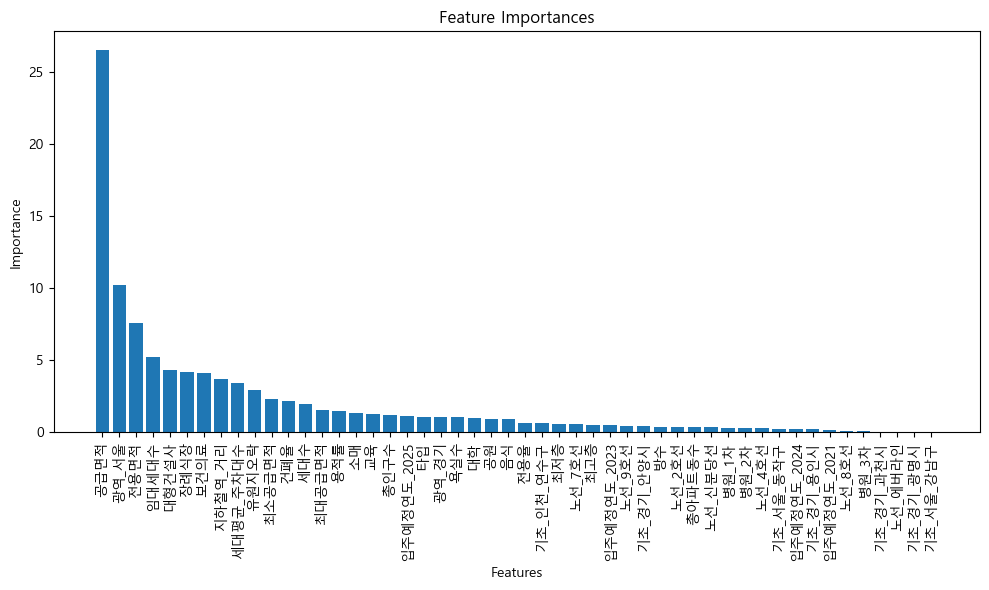

In [30]:
feature_importances = model.feature_importances_
feature_names = X.columns  # Assuming X is a pandas DataFrame with column names

# Sort the features and their importances in descending order
sorted_indices = np.argsort(feature_importances)[::-1]
sorted_importances = feature_importances[sorted_indices]
sorted_feature_names = feature_names[sorted_indices]

# Create a bar plot of feature importances
plt.figure(figsize=(10, 6))
plt.bar(range(len(sorted_importances)), sorted_importances)
plt.xticks(range(len(sorted_importances)), sorted_feature_names, rotation=90)
plt.xlabel('Features')
plt.ylabel('Importance')
plt.title('Feature Importances')
plt.tight_layout()
plt.show()

In [130]:
y_val_col3 = ['평당_공급액','평당공급액', '공급액']

In [131]:
df7 = df.drop(cate_list, axis=1)
df7.drop(y_val_col3,axis=1, inplace=True)

In [132]:
X = df7
y = df[y_val_col2]

In [133]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)


model_name = 'CatBoost'

model = CatBoostRegressor(
        n_estimators=2500,
        depth=6,
        learning_rate=0.199,
        l2_leaf_reg=4,
        colsample_bylevel=0.955,
        bagging_temperature=1.20,
        random_state=42
    )


model.fit(X_train_scaled, y_train, eval_set=(X_test_scaled, y_test), early_stopping_rounds=200)



y_pred = model.predict(X_test_scaled)

model_name = 'CatBoost'


mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)  # RMSE 계산
mae = mean_absolute_error(y_test, y_pred)  # MAE 계산
r2 = r2_score(y_test, y_pred)

print(f"{model_name} - RMSE: {rmse:.2f}, MAE: {mae:.2f}, MSE: {mse:.2f}, R2: {r2:.4f}")

0:	learn: 693.2183716	test: 687.2442496	best: 687.2442496 (0)	total: 2.96ms	remaining: 7.39s
1:	learn: 622.9668019	test: 621.2037285	best: 621.2037285 (1)	total: 5.05ms	remaining: 6.31s
2:	learn: 570.9827908	test: 574.0660387	best: 574.0660387 (2)	total: 7.94ms	remaining: 6.61s
3:	learn: 515.8042615	test: 521.5983982	best: 521.5983982 (3)	total: 10.2ms	remaining: 6.39s
4:	learn: 471.1552793	test: 478.6440074	best: 478.6440074 (4)	total: 12.3ms	remaining: 6.14s
5:	learn: 436.0957610	test: 445.4173079	best: 445.4173079 (5)	total: 15.2ms	remaining: 6.31s
6:	learn: 399.0841273	test: 410.2767466	best: 410.2767466 (6)	total: 17.3ms	remaining: 6.16s
7:	learn: 374.0639555	test: 386.8166448	best: 386.8166448 (7)	total: 19.6ms	remaining: 6.11s
8:	learn: 357.5134357	test: 370.9127785	best: 370.9127785 (8)	total: 22.4ms	remaining: 6.21s
9:	learn: 339.5519386	test: 353.3191972	best: 353.3191972 (9)	total: 24.6ms	remaining: 6.13s
10:	learn: 323.3475193	test: 337.3706344	best: 337.3706344 (10)	total:

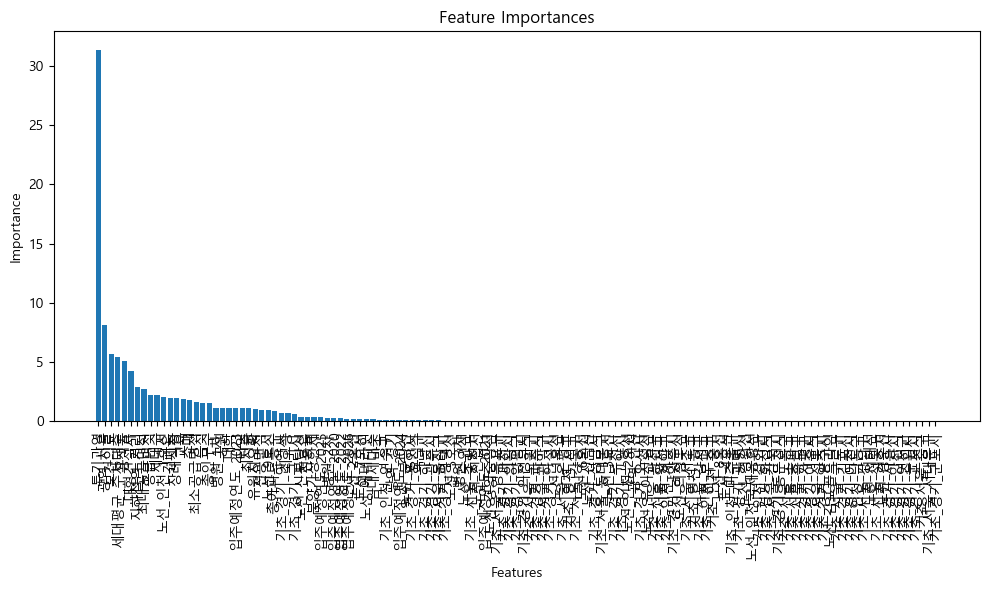

In [136]:
feature_importances = model.feature_importances_
feature_names = X.columns  # Assuming X is a pandas DataFrame with column names

# Sort the features and their importances in descending order
sorted_indices = np.argsort(feature_importances)[::-1]
sorted_importances = feature_importances[sorted_indices]
sorted_feature_names = feature_names[sorted_indices]

# Create a bar plot of feature importances
plt.figure(figsize=(10, 6))
plt.bar(range(len(sorted_importances)), sorted_importances)
plt.xticks(range(len(sorted_importances)), sorted_feature_names, rotation=90)
plt.xlabel('Features')
plt.ylabel('Importance')
plt.title('Feature Importances')
plt.tight_layout()
plt.show()

Shrink model to first 837 iterations.
CatBoost - RMSE: 130.95, MAE: 72.85, MSE: 17148.07, R2: 0.9714

평당 값은 공급면적이 생각보다 큰 영향을 안줌

하지만 공급액은 공급면적에 큰 영향을 준다.